In [ ]:
# SVM classifier using KNN
svm_knn = SVC(kernel='linear')
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)
svm_knn.fit(X_train_flat, y_train)
svm_knn_predictions = svm_knn.predict(X_test_flat)
print(svm_knn_predictions[:10])
svm_knn_accuracy = accuracy_score(y_test, svm_knn_predictions)
print("SVM classifier using KNN Accuracy:", svm_knn_accuracy)

# Softmax classifier using KNN
softmax_knn = KNeighborsClassifier(n_neighbors=10)  # You can tune n_neighbors
softmax_knn.fit(X_train_flat, y_train)
softmax_knn_predictions = softmax_knn.predict(X_test_flat)
softmax_knn_accuracy = accuracy_score(y_test, softmax_knn_predictions)
print("Softmax classifier using KNN Accuracy:", softmax_knn_accuracy)


[1 1 8 0 4 3 3 6 4 1]
SVM classifier using KNN Accuracy: 0.304
Softmax classifier using KNN Accuracy: 0.277


**Lab 6**

**Object Detection Using single stage detector Using YOLO**

In [ ]:
# Ensure required packages are installed
!pip install ultralytics  # Install YOLO package
!pip install opencv-python-headless  # To use OpenCV functions


In [ ]:
import cv2  # OpenCV for image handling
from ultralytics import YOLO  # YOLO model
import matplotlib.pyplot as plt  # For plotting images
import numpy as np  # For numerical operations
from google.colab.patches import cv2_imshow  # For displaying images in Colab


**Load a Pre-Trained YOLOv5 Model**

In [ ]:
!pip install --upgrade ultralytics


In [ ]:
from google.colab import files
uploaded = files.upload()  # Upload the yolov5s.pt file


Saving yolov5s-seg.pt to yolov5s-seg.pt


In [ ]:
# Ensure the correct model path is specified
model_path = "/content/yolov5s.pt"  # If you uploaded to Colab
model = YOLO(model_path)  # Load the model from a specific path


PRO TIP 💡 Replace 'model=/content/yolov5s.pt' with new 'model=/content/yolov5su.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 17.7M/17.7M [00:00<00:00, 92.7MB/s]


In [ ]:
from google.colab import files

uploaded = files.upload()  # Upload an image manually
image_path = list(uploaded.keys())[0]  # Get the name of the uploaded file


Saving tr.jpg to tr.jpg


In [ ]:
from google.colab import drive

# Mount Google Drive to access files
drive.mount('/content/drive')

# Define the image path in Google Drive
image_path = "/content/drive/MyDrive/tr.jpg"  # Change to your image's path


Mounted at /content/drive


In [ ]:
# Double-check the image path
image_path = "/content/tr.jpg"  # Adjust based on your image location

# Try to read the image again
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError(f"Image at '{image_path}' not found.")


In [ ]:
# Load the image
image = cv2.imread(image_path)  # Read the image from the specified path
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for plotting

# Perform object detection
results = model(image_rgb)  # Perform detection
detections = results[0]  # First (and only) detection result



0: 448x640 1 person, 17 cars, 3 trucks, 866.4ms
Speed: 21.4ms preprocess, 866.4ms inference, 4812.4ms postprocess per image at shape (1, 3, 448, 640)


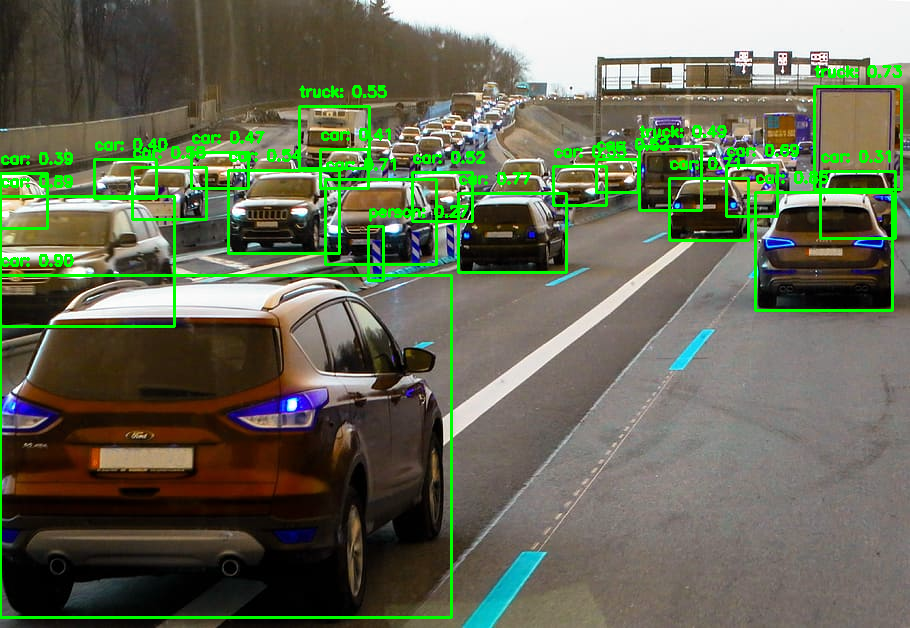

In [ ]:
import cv2
import torch

# Create a copy of the image to draw bounding boxes
image_with_boxes = image_rgb.copy()

# Loop through detected objects and draw bounding boxes with labels
for detection in detections.boxes:
    # Get bounding box coordinates
    box = detection.xyxy[0].cpu().numpy()
    class_id = int(detection.cls)  # Class ID
    confidence = float(detection.conf)  # Confidence score
    label = model.names[class_id]  # Get the class name

    # Draw the bounding box
    x1, y1, x2, y2 = map(int, box)  # Convert coordinates to integers
    cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Draw box

    # Convert confidence to float and draw the text with correct formatting
    cv2.putText(image_with_boxes, f"{label}: {confidence:.2f}", (x1, y1 - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)  # Add label

# Display the image with bounding boxes
from google.colab.patches import cv2_imshow  # To display images in Colab
cv2_imshow(image_with_boxes)


**object detection with two stage detectors Yolo**



In [ ]:
# Install Git and clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5

# Install required packages, including PyTorch
!pip install -r requirements.txt


fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/yolov5


In [ ]:
# Download a sample image
!wget -O sample_image.jpg https://ultralytics.com/images/zidane.jpg

# Run YOLOv5 with pre-trained model 'yolov5s.pt' (small model)
!python detect.py --weights yolov5s.pt --source sample_image.jpg --conf 0.5


--2024-05-03 19:07:26--  https://ultralytics.com/images/zidane.jpg
Resolving ultralytics.com (ultralytics.com)... 75.2.70.75, 99.83.190.102
Connecting to ultralytics.com (ultralytics.com)|75.2.70.75|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.ultralytics.com/images/zidane.jpg [following]
--2024-05-03 19:07:26--  https://www.ultralytics.com/images/zidane.jpg
Resolving www.ultralytics.com (www.ultralytics.com)... 104.18.0.125, 104.18.1.125, 2606:4700::6812:17d, ...
Connecting to www.ultralytics.com (www.ultralytics.com)|104.18.0.125|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://raw.githubusercontent.com/ultralytics/yolov5/master/data/images/zidane.jpg [following]
--2024-05-03 19:07:27--  https://raw.githubusercontent.com/ultralytics/yolov5/master/data/images/zidane.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.1

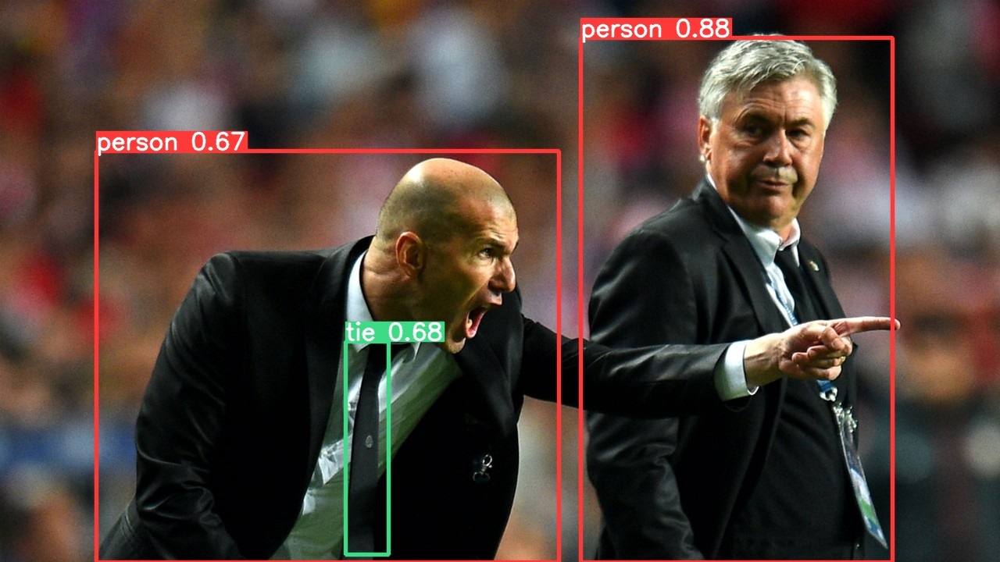

In [ ]:
from PIL import Image
import IPython.display as display

# Load and display the detected image from the output directory
output_image_path = 'runs/detect/exp/sample_image.jpg'  # Adjust as needed
image = Image.open(output_image_path)
display.display(image)


**Object detection using single detector SSD**

**SSD**

In [15]:
!pip install torch torchvision


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 75.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 37.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 70.0 MB/s eta 0:00:00


In [16]:
import torch
import torchvision
from torchvision import transforms

# Load a pre-trained SSD model with a specified backbone (like VGG16)
model = torchvision.models.detection.ssd300_vgg16(pretrained=True)
model.eval()  # Set the model to evaluation mode


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SSD300_VGG16_Weights.COCO_V1`. You can also use `weights=SSD300_VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/ssd300_vgg16_coco-b556d3b4.pth" to /root/.cache/torch/hub/checkpoints/ssd300_vgg16_coco-b556d3b4.pth
100%|██████████| 136M/136M [00:02<00:00, 60.4MB/s]


SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

In [17]:
import cv2
from PIL import Image

# Load the image using OpenCV and convert it to RGB
image_path = "/content/carr.jpg"  # Change to your image path
image = cv2.imread(image_path)  # Read the image
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for processing

# Define the necessary transformations for SSD
transform = transforms.Compose([
    transforms.ToPILImage(),  # Convert to PIL Image
    transforms.Resize((300, 300)),  # Resize to SSD's expected input size
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),  # Normalize
])

# Apply the transformations
image_tensor = transform(image_rgb).unsqueeze(0)  # Add a batch dimension


In [18]:
# Perform object detection
with torch.no_grad():
    detections = model(image_tensor)  # Perform detection

# Get the detected objects from the output
boxes = detections[0]["boxes"]  # Bounding box coordinates
labels = detections[0]["labels"]  # Class labels
scores = detections[0]["scores"]  # Confidence scores


In [26]:
# Extract bounding boxes from the detection results
boxes = detections[0]["boxes"]  # List of bounding box coordinates
scores = detections[0]["scores"]  # Confidence scores for each box
labels = detections[0]["labels"]  # Class labels

# Ensure we're using the correct variable names
image_with_boxes = image_rgb.copy()  # Create a copy of the original image for drawing bounding boxes

# Set a confidence threshold
threshold = 0.5

# Loop through the detected boxes
for box, score, label in zip(boxes, scores, labels):
    if score >= threshold:  # Apply the confidence threshold
        # Ensure box coordinates are integers
        x1, y1, x2, y2 = map(int, box.tolist())  # Convert to integers
        # Ensure coordinates are ordered correctly
        x1, x2 = sorted([x1, x2])
        y1, y2 = sorted([y1, y2])

        # Draw the bounding box
        cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Get the class name from the label index (COCO classes, for example)
        coco_classes = ["__background__", "person", "bicycle", "car", "motorcycle", "airplane", "bus", "train", "truck", "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", ]


In [28]:
# Extract and ensure coordinates are integers
x1, y1, x2, y2 = box.int().tolist()  # Get integer coordinates and convert to list


In [29]:
# Ensure that the bounding box coordinates are in the correct order
x1, x2 = sorted([x1, x2])  # Ensure x1 < x2
y1, y2 = sorted([y1, y2])  # Ensure y1 < y2


In [30]:
# Convert coordinates to integers
x1 = int(x1)
y1 = int(y1)
x2 = int(x2)
y2 = int(y2)


In [31]:
# COCO dataset class names
coco_classes = [
    "__background__", "person", "bicycle", "car", "motorcycle", "airplane", "bus",
    "train", "truck", "boat", "traffic light", "fire hydrant", "stop sign", "parking meter",

]


In [32]:
# Loop through the detected objects and draw bounding boxes
for box, label, score in zip(boxes, labels, scores):
    if score >= 0.5:  # Only keep detections with a confidence score of 0.5 or higher
        # Get bounding box coordinates and ensure they're integers
        x1, y1, x2, y2 = map(int, box.cpu().tolist())  # Convert tensor to list and then to integers

        # Ensure bounding box coordinates are in the correct order
        x1, x2 = sorted([x1, x2])  # Ensure x1 < x2
        y1, y2 = sorted([y1, y2])  # Ensure y1 < y2

        # Draw the bounding box
        cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Get the class name from the label index
        class_name = "Unknown"  # Default fallback class name
        if 0 <= label < len(coco_classes):  # Ensure label index is valid
            class_name = coco_classes[int(label)]

        # Draw the label and confidence score
        text = f"{class_name}: {float(score):.2f}"  # Ensure confidence is a float
        cv2.putText(image_with_boxes, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


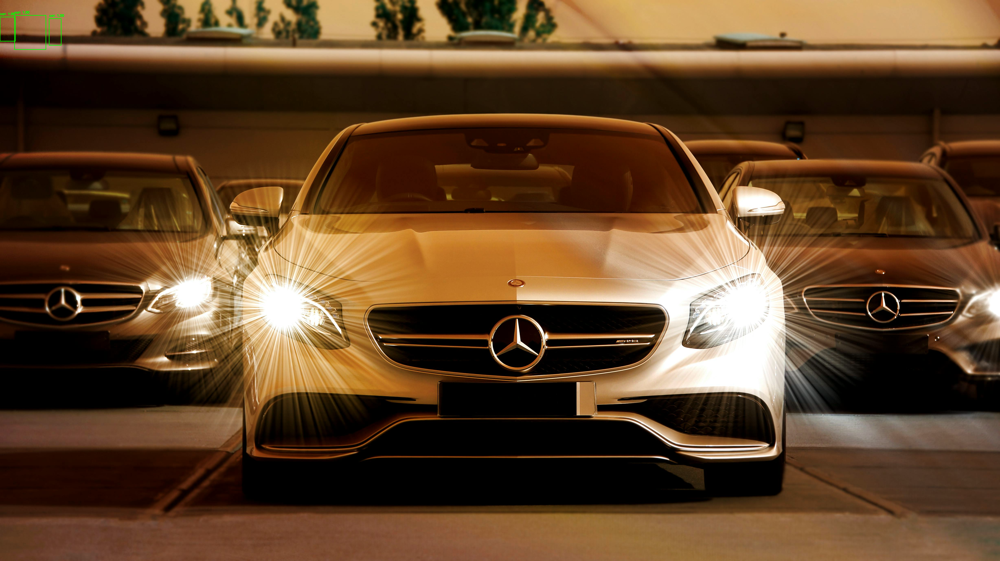

In [33]:
# Display the image with bounding boxes
from google.colab.patches import cv2_imshow
cv2_imshow(image_with_boxes)

In [34]:
import cv2
import numpy as np
import torchvision.transforms as transforms
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import torch

# Ensure consistent image size throughout
image_path = "/content/carr.jpg"  # Replace with your image path
image = cv2.imread(image_path)  # Read the image using OpenCV
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for PIL and PyTorch

# Define the necessary transformations for SSD
transform = transforms.Compose([
    transforms.ToPILImage(),  # Convert OpenCV image to PIL
    transforms.Resize((300, 300)),  # Resize to match SSD input size
    transforms.ToTensor(),  # Convert to tensor
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),  # Normalize for SSD
])

# Convert to tensor and add batch dimension
image_tensor = transform(image_rgb).unsqueeze(0)

# Load a pre-trained SSD model
model = torchvision.models.detection.ssd300_vgg16(pretrained=True)
model.eval()

# Perform object detection
with torch.no_grad():
    detections = model(image_tensor)

# Draw bounding boxes on a copy of the original image
image_with_boxes = image_rgb.copy()  # Ensure we're using the original image


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SSD300_VGG16_Weights.COCO_V1`. You can also use `weights=SSD300_VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [38]:
boxes = detections[0]["boxes"]  # Bounding box coordinates
scores = detections[0]["scores"]  # Confidence scores
labels = detections[0]["labels"]  # Class labels

# Define a threshold to filter low-confidence detections
threshold = 2.5

# Loop through the detections and draw bounding boxes on the image
for box, score, label in zip(boxes, scores, labels):
    if score >= threshold:  # Apply the confidence threshold
        # Convert bounding box coordinates to integers
        x1, y1, x2, y2 = map(int, box.tolist())

        # Draw the bounding box and ensure coordinates are in order
        x1, x2 = sorted([x1, x2])
        y1, y2 = sorted([y1, y2])

        # Draw the bounding box and label
        cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), (0, 255, 0), 2)
        class_name = "Object"  # Default class name
        text = f"{class_name}: {score:.2f}"
        cv2.putText(image_with_boxes, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 2.5, (0, 255, 0), 2)


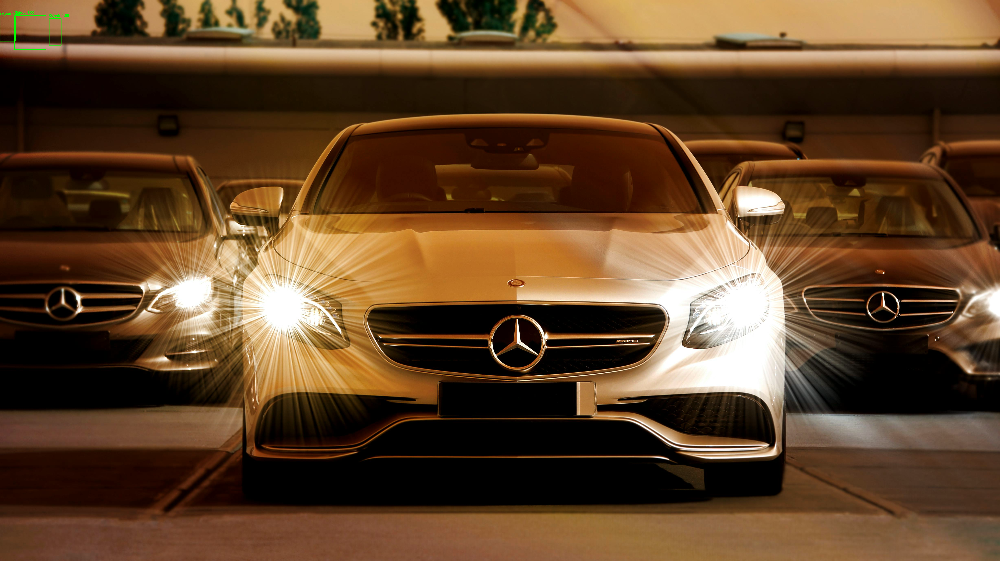

In [36]:
from google.colab.patches import cv2_imshow  # For displaying images in Google Colab
cv2_imshow(image_with_boxes)  # Show the image with bounding boxes


**(Faster R-CNN**

In [1]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn

object_detection_model = fasterrcnn_resnet50_fpn(pretrained=True, progress=False)

object_detection_model.eval(); ## Setting Model for Evaluation/Prediction

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


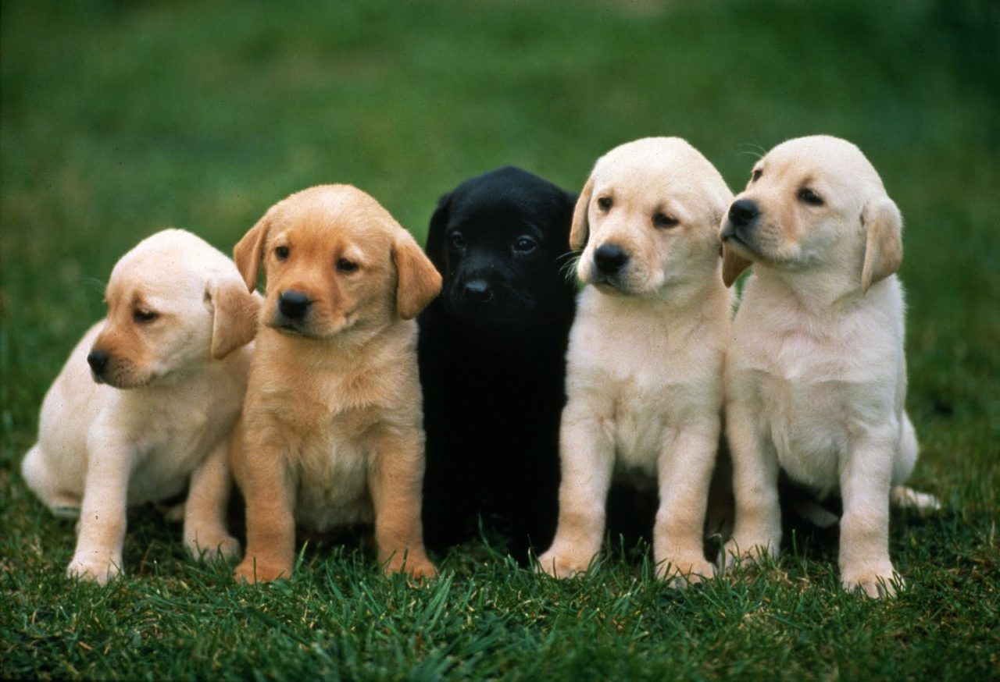

In [3]:
from PIL import Image

test_img = Image.open("dog.jpeg")

test_img

In [4]:
import torchvision.transforms as transforms

# Load the image
test_img = Image.open("dog.jpeg")

# Define the transformation - convert image to tensor
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Apply the transformation to the image
test_img_tensor = transform(test_img)
test_img_tensor

tensor([[[0.0118, 0.0510, 0.0588,  ..., 0.0471, 0.0431, 0.0431],
         [0.0118, 0.0510, 0.0627,  ..., 0.0471, 0.0471, 0.0431],
         [0.0157, 0.0549, 0.0627,  ..., 0.0510, 0.0471, 0.0471],
         ...,
         [0.0039, 0.0039, 0.0078,  ..., 0.0549, 0.0549, 0.0549],
         [0.0118, 0.0039, 0.0039,  ..., 0.0510, 0.0471, 0.0510],
         [0.0078, 0.0039, 0.0000,  ..., 0.0431, 0.0431, 0.0471]],

        [[0.1059, 0.1490, 0.1569,  ..., 0.1451, 0.1412, 0.1412],
         [0.1059, 0.1490, 0.1608,  ..., 0.1451, 0.1451, 0.1412],
         [0.1098, 0.1529, 0.1608,  ..., 0.1490, 0.1451, 0.1451],
         ...,
         [0.0235, 0.0275, 0.0314,  ..., 0.0902, 0.0863, 0.0902],
         [0.0196, 0.0235, 0.0235,  ..., 0.0824, 0.0784, 0.0824],
         [0.0157, 0.0118, 0.0157,  ..., 0.0745, 0.0745, 0.0784]],

        [[0.0039, 0.0353, 0.0431,  ..., 0.0627, 0.0588, 0.0588],
         [0.0039, 0.0353, 0.0471,  ..., 0.0627, 0.0627, 0.0588],
         [0.0078, 0.0392, 0.0471,  ..., 0.0667, 0.0627, 0.

In [5]:
test_img_tensor.shape

torch.Size([3, 874, 1280])

In [6]:
#  We added this dimension because models work on batches of images.
test_img_tensor = test_img_tensor.unsqueeze(dim=0)
test_img_tensor.shape

torch.Size([1, 3, 874, 1280])

In [7]:
preds = object_detection_model(test_img_tensor)
preds

[{'boxes': tensor([[ 267.1400,  231.8589,  565.2549,  759.2933],
          [ 681.2696,  170.0222,  960.5222,  773.0205],
          [ 523.0118,  204.4522,  745.7932,  741.6026],
          [ 917.8345,  173.1901, 1175.0020,  763.4681],
          [  31.2755,  290.0895,  337.3121,  739.9094],
          [ 688.9031,  186.2837,  957.1257,  747.7374],
          [ 135.7344,  201.8596, 1001.3845,  753.1362],
          [ 914.5043,  198.5515, 1177.4241,  761.2520],
          [ 691.4178,  174.7795,  955.4492,  753.2247],
          [ 528.2272,  216.3323,  757.2753,  742.4715],
          [ 273.2733,  280.5003,  560.1556,  743.3676],
          [ 918.0241,  230.8339, 1179.8586,  763.9484],
          [  24.5103,  343.1167,  331.5239,  743.4681]],
         grad_fn=<StackBackward0>),
  'labels': tensor([18, 18, 18, 18, 18, 20, 18, 20, 23, 23, 23, 23, 20]),
  'scores': tensor([0.9947, 0.9899, 0.9891, 0.9856, 0.9818, 0.4907, 0.3877, 0.1418, 0.1176,
          0.0905, 0.0875, 0.0760, 0.0509], grad_fn=<IndexBac

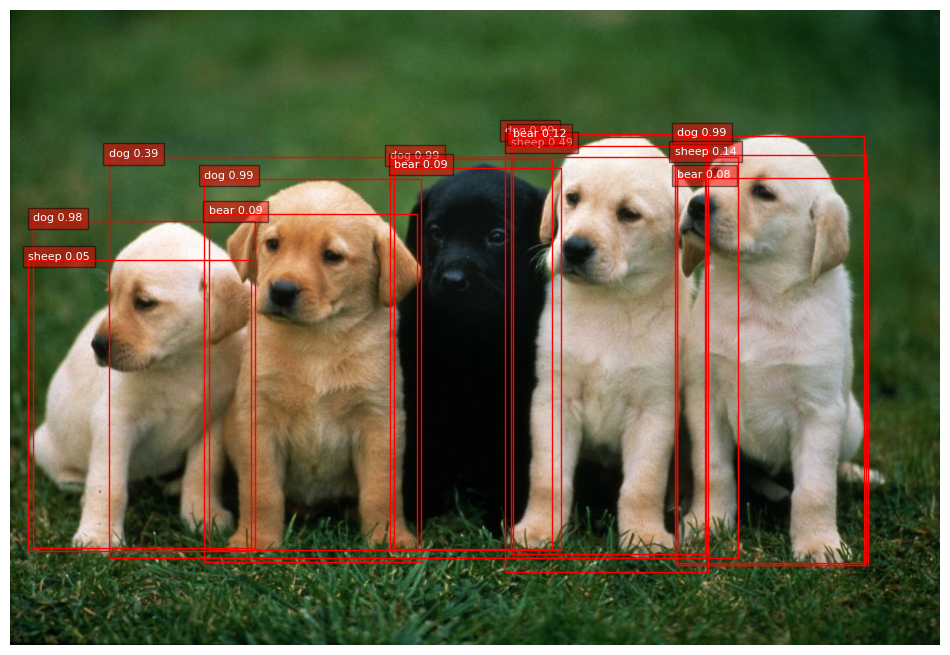

In [8]:
# COCO dataset class labels (commonly used for pre-trained models)

COCO_INSTANCE_CATEGORY_NAMES = [
    '','__background__','person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat',
    'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog',
    'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite',
    'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle',
    'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich',
    'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote',
    'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]


# Visualization with class names
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Convert tensor image back to numpy for visualization
img = test_img_tensor.squeeze().detach().cpu().numpy()  # Adjust dimensions as necessary
img = img.transpose(1, 2, 0)  # Rearrange the dimensions from CxHxW to HxWxC for image display

# Create figure and axes
fig, ax = plt.subplots(1, figsize=(12, 9))

# Display the image
ax.imshow(img)

# Add bounding boxes and labels
for box, label, score in zip(preds[0]['boxes'], preds[0]['labels'], preds[0]['scores']):
    x1, y1, x2, y2 = box.detach().cpu().numpy()  # Make sure to detach and convert boxes as well
    label_name = COCO_INSTANCE_CATEGORY_NAMES[label.item()]
    rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
    plt.text(x1, y1, f'{label_name} {score.item():.2f}', color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))

plt.axis('off')  # to turn off axes for better visualization
plt.show()

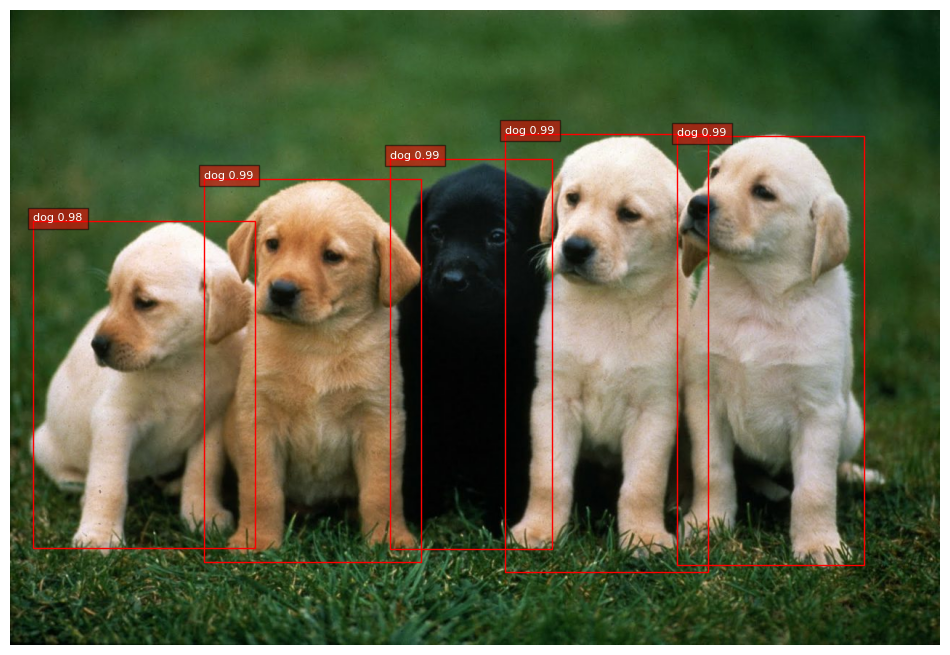

In [9]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Set a threshold for displaying predictions
CONFIDENCE_THRESHOLD = 0.8  # for example, 50%

# Convert tensor image back to numpy for visualization
img = test_img_tensor.squeeze().detach().cpu().numpy()  # Adjust dimensions as necessary
img = img.transpose(1, 2, 0)  # Rearrange the dimensions from CxHxW to HxWxC for image display

# Create figure and axes
fig, ax = plt.subplots(1, figsize=(12, 9))

# Display the image
ax.imshow(img)

# Add bounding boxes and labels
for box, label, score in zip(preds[0]['boxes'], preds[0]['labels'], preds[0]['scores']):
    if score.item() > CONFIDENCE_THRESHOLD:
        x1, y1, x2, y2 = box.detach().cpu().numpy()  # Make sure to detach and convert boxes as well

        # Adjust for potential off-by-one error
        label_index = label.item()  # Assuming model's labels are 0-indexed
        # If labels are 1-indexed, subtract 1: label_index = label.item() - 1

        label_name = COCO_INSTANCE_CATEGORY_NAMES[label_index]
        rect = patches.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
        plt.text(x1, y1, f'{label_name} {score.item():.2f}', color='white', fontsize=8, bbox=dict(facecolor='red', alpha=0.5))

plt.axis('off')  # to turn off axes for better visualization
plt.show()

**EXP 5**

**Image segmentation using Mask RCNN,**

In [ ]:
!git clone https://github.com/matterport/Mask_RCNN.git

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 137.67 MiB | 29.41 MiB/s, done.
Resolving deltas: 100% (558/558), done.


In [ ]:
import os
os.chdir('Mask_RCNN/samples')

In [ ]:
# Uninstall TensorFlow if already installed to start fresh
!pip uninstall -y tensorflow

# Install a compatible version of TensorFlow (e.g., 2.8 or higher)
!pip install tensorflow==2.8


Found existing installation: tensorflow 2.8.0
Uninstalling tensorflow-2.8.0:
  Successfully uninstalled tensorflow-2.8.0
  Using cached tensorflow-2.8.0-cp310-cp310-manylinux2010_x86_64.whl (497.6 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.15.1 requires tensorflow<2.16,>=2.15, but you have tensorflow 2.8.0 which is incompatible.


In [ ]:
# Clone the repository (make sure it's updated for TensorFlow 2.x)
!git clone https://github.com/matterport/Mask_RCNN.git
%cd Mask_RCNN

# Install dependencies
!pip install -r requirements.txt


fatal: destination path 'Mask_RCNN' already exists and is not an empty directory.
/content/Mask_RCNN


In [ ]:
# Correct import path for Keras Layer in TensorFlow 2.x
from tensorflow.keras import layers as KE
